# hologram gen

In [4]:
import torch
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np
from pytictoc import TicToc
import torch.nn as nn
import torch.nn.functional as F

def FresnelPropagation_as(input, dx, dy, z, wavelength):
    device = "cuda" if torch.cuda.is_available() else "cpu"
    torch.cuda.empty_cache()

    k = 2 * torch.pi / wavelength
    Nx, Ny = input.shape
    Nxx = 2 * Nx
    Nyy = 2 * Ny

    input2x = torch.zeros(Nxx, Nyy, dtype=input.dtype, device=device)
    start_x = round(Nx/2) - 1
    start_y = round(Ny/2) - 1
    input2x.narrow(0, start_x, Nx).narrow(1, start_y, Ny).copy_(input)

    dal = 1. / (Nxx * dx)  # delta alpha over lambda
    dbl = 1. / (Nyy * dy)  # delta beta over lambda

    al, bl = torch.meshgrid(torch.arange(Nxx, device=device), torch.arange(Nyy, device=device))
    al = (al - Nxx/2) * dal
    bl = (bl - Nyy/2) * dbl
    A = torch.fft.fftshift(torch.fft.fftn(torch.fft.ifftshift(input2x)))
    A = A.to(device)
    prop_kernel = torch.exp(1j * 2 * torch.pi * z * torch.sqrt(1 / wavelength ** 2 - al ** 2 - bl ** 2))
    prop_kernel = prop_kernel.to(device)

    # K. Matsushima et al., "Band-limited angular spectrum method for numerical simulation of free-space propagation
    # in far and near fields," Opt. Express 17, 19662 (2009) 참조
    # FresnelPropagationShift_as.m 과 동일. 다만 sx=sy=0
    sx = 0
    sy = 0
    fla = torch.abs(-al * z / torch.sqrt(1 / wavelength ** 2 - al ** 2 - bl ** 2) + sx)
    flb = torch.abs(-bl * z / torch.sqrt(1 / wavelength ** 2 - al ** 2 - bl ** 2) + sy)
    prop_kernel[(fla > 1 / (2 * dal)) | (flb > 1 / (2 * dbl))] = 0


    intermediate = torch.fft.ifftshift(torch.fft.ifftn(torch.fft.fftshift(A * prop_kernel)))

    output = intermediate.narrow(0, start_x, Nx).narrow(1, start_y, Ny)

    du = dx
    dv = dy

    return output, du, dv
def myfunc(input, px, py, z, wvl):

    input = input % (2*torch.pi)
    slm_field = 1+torch.exp(1j*input)
    slm_field = slm_field.to(device)
    fft_slm_field = torch.fft.ifftshift(torch.fft.fft2(torch.fft.fftshift(slm_field)))
    
    repnum = 3
    rep_fft_slm_field = fft_slm_field.repeat(repnum,repnum)*torch.sinc(pa*rep_fyfy) * torch.sinc(pa*rep_fxfx)

    
    rep_slm_field = torch.fft.fftshift(torch.fft.ifft2(torch.fft.ifftshift(rep_fft_slm_field)))
    
    output_tmp, du, dv = FresnelPropagation_as(rep_slm_field, px/3, py/3, z, wvl)
    # output = output_tmp[0:-1:repnum, 0:-1:repnum]
    # output = F.interpolate(output_tmp.abs().unsqueeze(0).unsqueeze(0), size=(imgNy, imgNx), mode='bilinear',align_corners=False).squeeze(0).squeeze(0)
    output = output_tmp
    return output, du, dv


# GPU 할당
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Using {} device: {}".format(device, torch.cuda.get_device_name(0)))

# hardware parameters
nm, um, mm, cm = np.array([1e-9, 1e-6, 1e-3, 1e-2])
px = torch.tensor(3.6*um)
py = px
fillfactor = 0.93
pa = fillfactor**0.5*px
wvl_laser = 520 * nm
z = -5*cm
iter = 500
fl_EP = 50*mm

# Target image 불러옴
img_name = 'jeju.png'
img = Image.open(img_name).convert("L")
img_array = np.array(img)  # convert the PIL image to a numpy array
img_tensor = torch.as_tensor(img_array, dtype=torch.float32)
img_tensor = img_tensor #.permute(1, 0)
imgNy, imgNx = img_tensor.size()
target_amp = img_tensor.to(device)


# Init phase 설정
init_phase = (torch.rand([imgNy, imgNx], dtype=torch.float32) * 2 * torch.pi).to(device)
slm_phase = init_phase.clone().requires_grad_(True).to(device)
imgNy, imgNx = slm_phase.size()

# Image size 설정
Nx, Ny = [1920, 1080]
init_phase = (torch.rand([Ny, Nx], dtype=torch.float32)*2*torch.pi).to(device)
full_slm_phase = torch.clone(init_phase)
full_slm_phase.requires_grad_(True)
lr = 1e-2
optimizer = torch.optim.Adam([{'params': full_slm_phase}], lr=lr)
loss_fn = nn.MSELoss(reduction='mean').to(device)

# ROI_size = (880, 1600)
# ROI_start = (100, 160)
ROI_size = (1080, 1920)
ROI_start = (0, 0)
tmp = torch.zeros_like(img_tensor)

prac_slm_phase = torch.zeros_like(img_tensor)
phase_img_norm = torch.zeros_like(img_tensor)

x = []
y = []
# initial random phase

target_amp = img_tensor.to(device)
target_amp = target_amp#[ROI_start[0]:ROI_start[0] +
                    #ROI_size[0], ROI_start[1]:ROI_start[1]+ROI_size[1]]
target_amp = F.interpolate(target_amp.abs().unsqueeze(0).unsqueeze(0), size=(3*imgNy, 3*imgNx), mode='bilinear',align_corners=False).squeeze(0).squeeze(0)


repnum = 3

rep_dfx = 1/(imgNx*px)
rep_dfy = 1/(imgNy*py)
rep_minfx = -repnum/(2*px)
rep_maxfx = repnum/(2*px)
rep_minfy = -repnum/(2*py)
rep_maxfy = repnum/(2*py)

rep_fx = torch.linspace(rep_minfx, rep_maxfx, repnum*imgNx)
rep_fy = torch.linspace(rep_minfy, rep_maxfy, repnum*imgNy)

rep_fyfy, rep_fxfx = torch.meshgrid(rep_fy,rep_fx)
rep_fyfy = rep_fyfy.to(device)
rep_fxfx = rep_fxfx.to(device)
for _ in range(1000):

    optimizer.zero_grad()
    recon_field, dx, dx = myfunc(full_slm_phase, px, py, z, wvl_laser)
    recon_amp = recon_field.abs()
    out_amp = recon_amp#[ROI_start[0]:ROI_start[0] +
                    #ROI_size[0], ROI_start[1]:ROI_start[1]+ROI_size[1]]

    s = target_amp.sum() / out_amp.sum()
    loss = loss_fn(s*out_amp, target_amp)
    loss.requires_grad_(True)
    loss.backward()
    optimizer.step()
    print("iteration: {}, loss: {}".format(_+1, loss))

    x.append(_)
    y.append(loss.cpu().detach().numpy())


Using cuda device: NVIDIA GeForce RTX 4090


c:\myPythoncode_MHChoi\torchtest1\lib\site-packages\torch\functional.py:505: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ..\aten\src\ATen\native\TensorShape.cpp:3489.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


iteration: 1, loss: 4719.0322265625
iteration: 2, loss: 4665.0927734375
iteration: 3, loss: 4611.54052734375
iteration: 4, loss: 4558.38427734375
iteration: 5, loss: 4505.6298828125
iteration: 6, loss: 4453.28271484375
iteration: 7, loss: 4401.34619140625
iteration: 8, loss: 4349.8232421875
iteration: 9, loss: 4298.716796875
iteration: 10, loss: 4248.0283203125
iteration: 11, loss: 4197.7587890625
iteration: 12, loss: 4147.90869140625
iteration: 13, loss: 4098.4765625
iteration: 14, loss: 4049.46435546875
iteration: 15, loss: 4000.870361328125
iteration: 16, loss: 3952.69189453125
iteration: 17, loss: 3904.9296875
iteration: 18, loss: 3857.580322265625
iteration: 19, loss: 3810.64306640625
iteration: 20, loss: 3764.1142578125
iteration: 21, loss: 3717.99267578125
iteration: 22, loss: 3672.274658203125
iteration: 23, loss: 3626.959228515625
iteration: 24, loss: 3582.04248046875
iteration: 25, loss: 3537.52197265625
iteration: 26, loss: 3493.3955078125
iteration: 27, loss: 3449.658935546

In [5]:
def mypupil(Nx, Ny, dx, dy, pupilRad, offsetX, offsetY, wvl, fl_EP, repnum):
    dfx = 1 / (Nx * dx)
    dfy = 1 / (Ny * dy)

    minfx = -repnum * Nx / 2 * dfx
    maxfx = repnum * Nx / 2 * dfx
    minfy = -repnum * Ny / 2 * dfy
    maxfy = repnum * Ny / 2 * dfy

    fx = torch.linspace(minfx, maxfx, repnum * Nx)
    fy = torch.linspace(minfy, maxfy, repnum * Ny)

    flx = wvl * fl_EP * fx
    fly = wvl * fl_EP * fy

    flyfly, flxflx = torch.meshgrid(fly, flx)

    pupilMat = torch.zeros([repnum * Ny, repnum * Nx], dtype=torch.float32)
    pupilMat[(flxflx - offsetX) ** 2 + (flyfly - offsetY) ** 2 < (pupilRad) ** 2] = 1

    return pupilMat, flx, fly

C:\Users\user\AppData\Local\Temp\ipykernel_36392\547832754.py:54: RuntimeWarning: divide by zero encountered in log
  ax.imshow(np.log(abs_filtered_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])
C:\Users\user\AppData\Local\Temp\ipykernel_36392\547832754.py:97: RuntimeWarning: divide by zero encountered in log
  ax.imshow(np.log(abs_filtered_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])


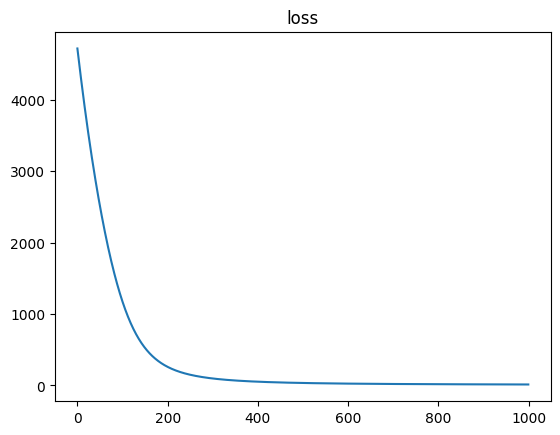

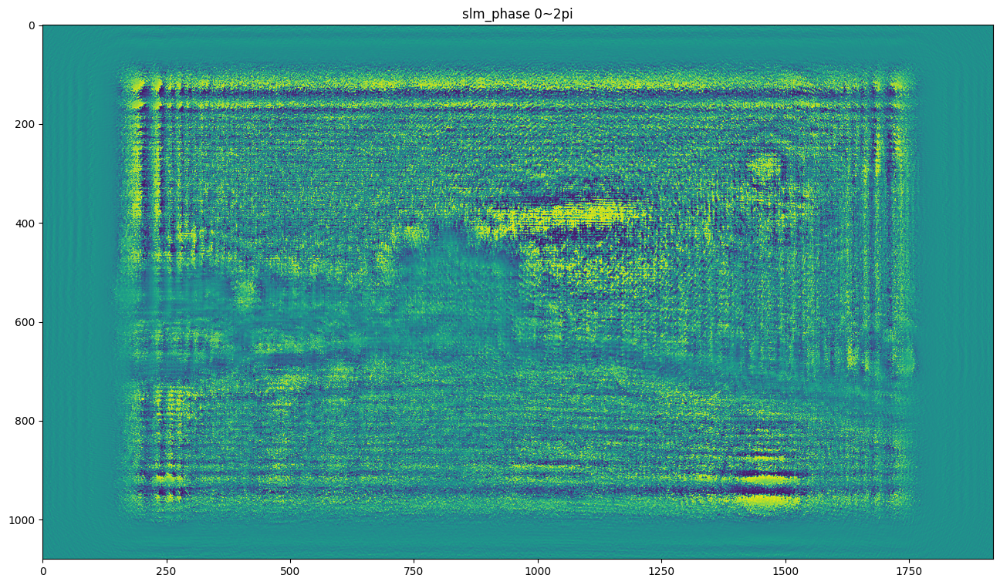

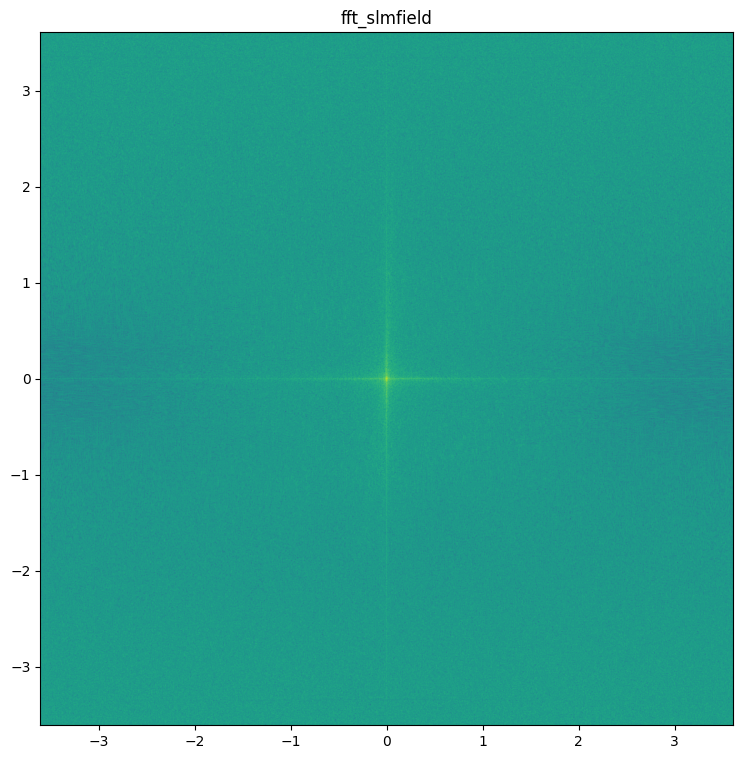

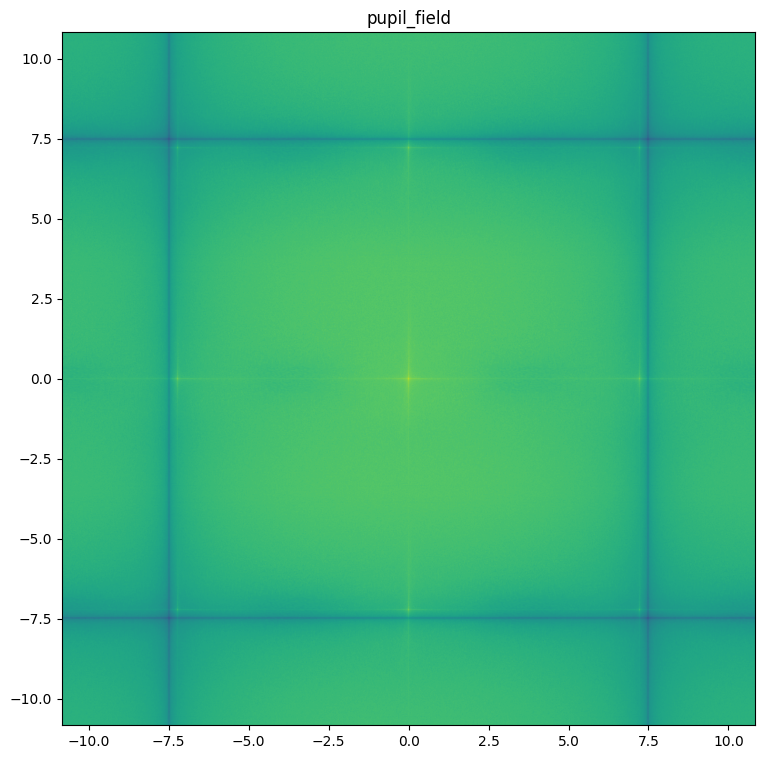

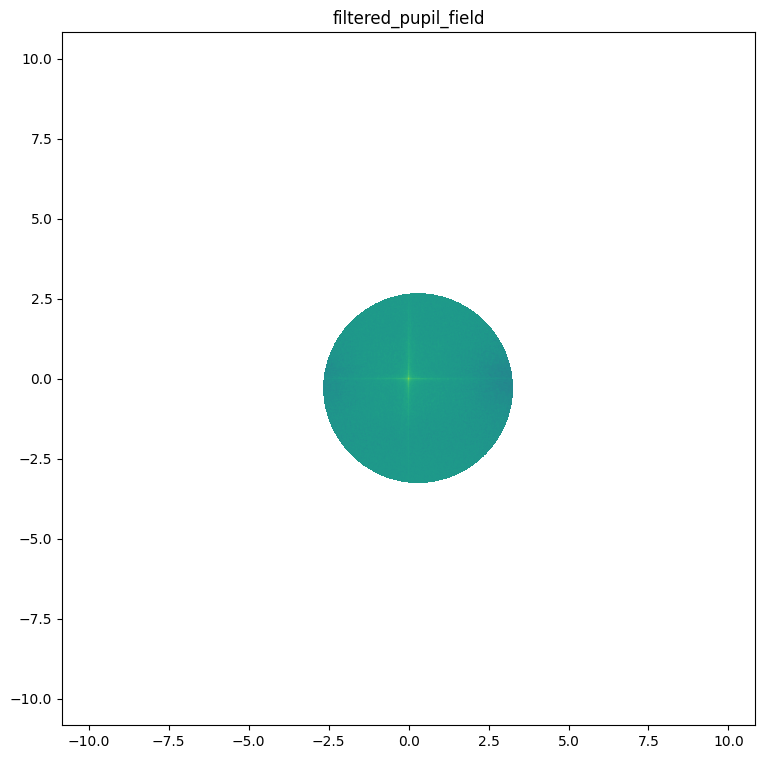

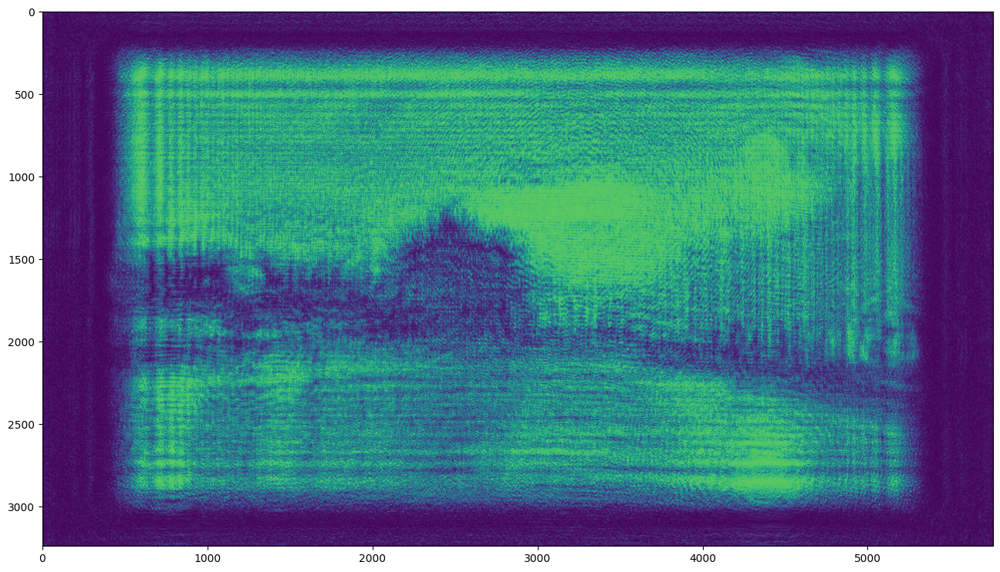

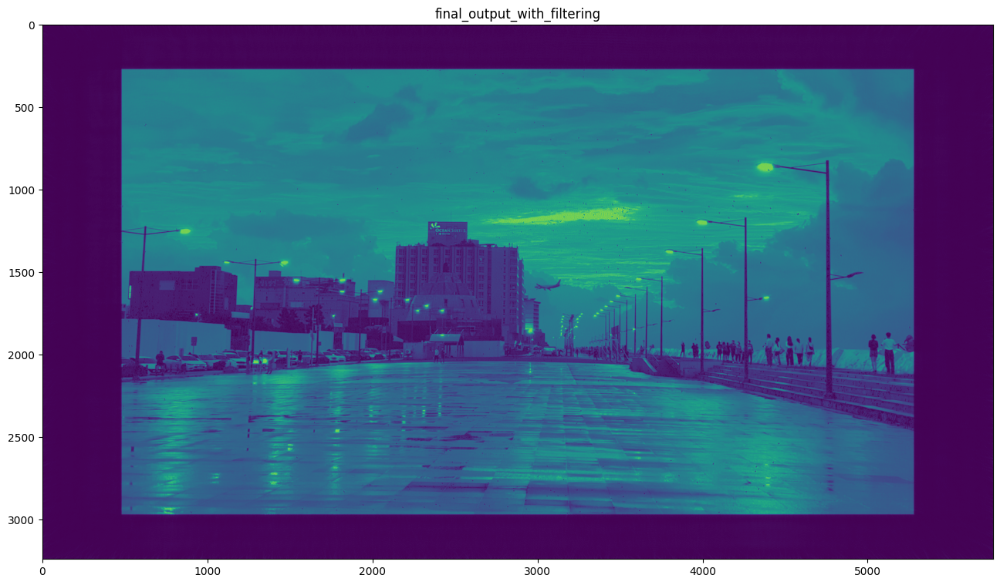

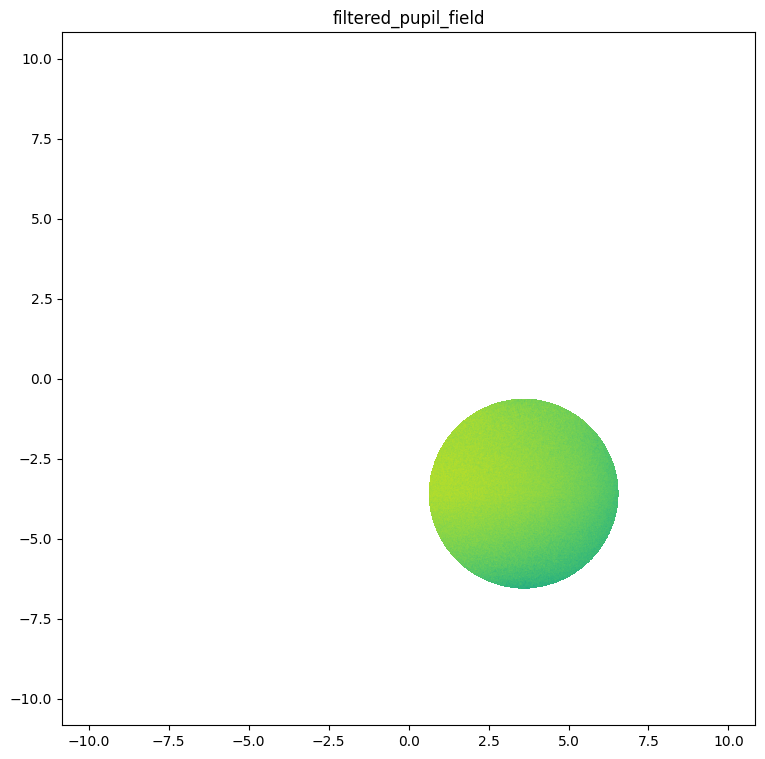

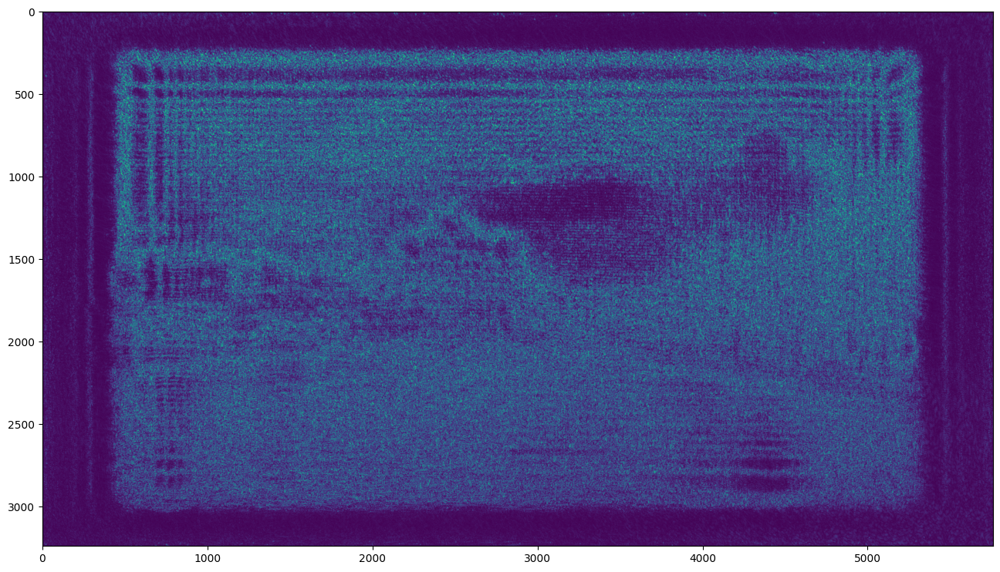

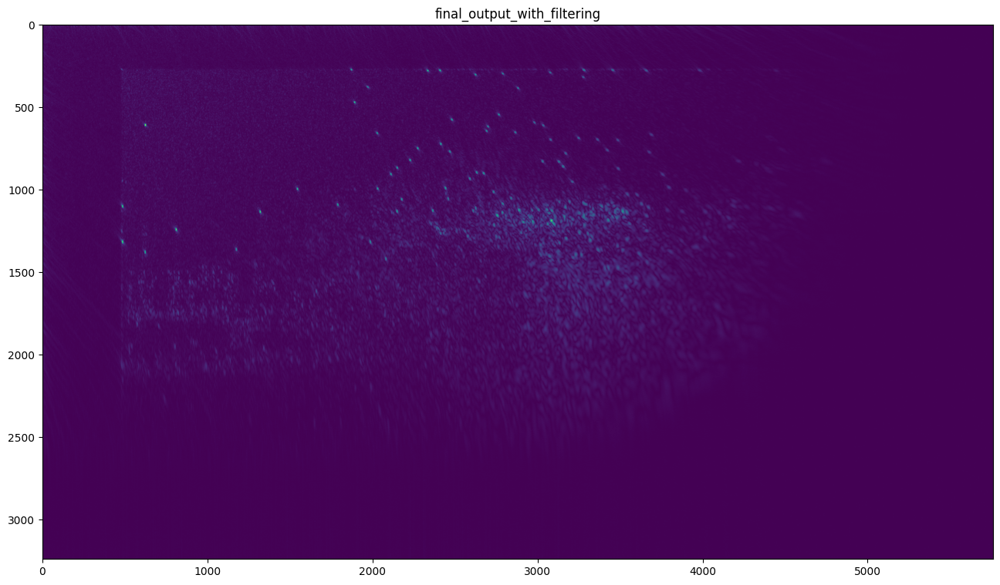

In [11]:
from matplotlib import cm
plt.figure()
plt.plot(x,y)
plt.title('loss')

pupil_func, flx, fly = mypupil(imgNx, imgNy, px, py, 3 * mm, 2.5 * mm, 2.5 * mm, wvl_laser, fl_EP, 3)

prac_slm_phase = full_slm_phase % (2*torch.pi)
abs_prac_slm_phase = torch.clone(prac_slm_phase)
plt.figure(figsize=(16,9))
plt.imshow(abs(prac_slm_phase.cpu().detach()))
plt.title('slm_phase 0~2pi')
# img_prac_slm_phase = prac_slm_phase / torch.max(prac_slm_phase)
# img_prac_slm_phase = Image.fromarray(np.uint8(255*img_prac_slm_phase.cpu().detach().numpy()))
# img_prac_slm_phase.save('SLMphase={}mm_{}'.format(z/mm, img_name))
abs_prac_slm_phase = abs_prac_slm_phase - torch.min(abs_prac_slm_phase)
abs_prac_slm_phase = abs_prac_slm_phase / torch.max(abs_prac_slm_phase)
abs_prac_slm_phase = Image.fromarray(np.uint8(255*cm.viridis(abs_prac_slm_phase.cpu().detach())))
abs_prac_slm_phase.save('DH_phase.png')

pupil_field = torch.fft.ifftshift(torch.fft.fft2(torch.fft.fftshift(1+torch.exp(1j*prac_slm_phase))))
abs_pupil_field = abs(pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_pupil_field.cpu().detach()), extent=[min(flx/3)/mm, max(flx/3)/mm, min(fly/3)/mm, max(fly/3)/mm])
plt.title('fft_slmfield')
abs_pupil_field = abs_pupil_field - torch.min(abs_pupil_field)
abs_pupil_field = torch.log(abs_pupil_field)
abs_pupil_field = abs_pupil_field / torch.max(abs_pupil_field)
abs_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_pupil_field.cpu().detach())))
abs_pupil_field.save('DH_FFTfield.png')

rep_pupil_field = pupil_field.repeat(repnum,repnum)*torch.sinc(pa*rep_fyfy) * torch.sinc(pa*rep_fxfx)
abs_rep_pupil_field = abs(rep_pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_rep_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])
plt.title('pupil_field')
abs_rep_pupil_field = abs_rep_pupil_field - torch.min(abs_rep_pupil_field)
abs_rep_pupil_field = torch.log(abs_rep_pupil_field)
abs_rep_pupil_field = abs_rep_pupil_field / torch.max(abs_rep_pupil_field)
abs_rep_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_rep_pupil_field.cpu().detach())))
abs_rep_pupil_field.save('DH_repFFTfield.png')

# pupil_func, flx, fly = mypupil(imgNx, imgNy, px, py, 3 * mm, 3.6 * mm, 3.6 * mm, wvl_laser, fl_EP, 3)
pupil_func, flx, fly = mypupil(imgNx, imgNy, px, py, 3 * mm, 0.3 * mm, 0.3 * mm, wvl_laser, fl_EP, 3)
abs_pupil_func = torch.clone(pupil_func)
abs_pupil_func = abs_pupil_func - torch.min(abs_pupil_func)
abs_pupil_func = abs_pupil_func / torch.max(abs_pupil_func)
abs_pupil_func = Image.fromarray(np.uint8(255*cm.viridis(abs_pupil_func.cpu().detach())))
abs_pupil_func.save('DH_pupilwanted.png')

filtered_pupil_field = rep_pupil_field * pupil_func.to(device)
abs_filtered_pupil_field = abs(filtered_pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_filtered_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])
plt.title('filtered_pupil_field')
abs_filtered_pupil_field = abs_filtered_pupil_field - torch.min(abs_filtered_pupil_field)
abs_filtered_pupil_field = torch.log(abs_filtered_pupil_field)
abs_filtered_pupil_field = abs_filtered_pupil_field / torch.max(abs_filtered_pupil_field)
abs_filtered_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_pupil_field.cpu().detach())))
abs_filtered_pupil_field.save('DH_filteredFFTfield_wantedpupil.png')

filtered_slm_field = torch.fft.fftshift(torch.fft.ifft2(torch.fft.ifftshift(filtered_pupil_field)))
abs_filtered_slm_field = torch.abs(filtered_slm_field)
plt.figure(figsize=(16,9))
plt.imshow(abs_filtered_slm_field.cpu().detach())
abs_filtered_slm_field = abs_filtered_slm_field - torch.min(abs_filtered_slm_field)
abs_filtered_slm_field = abs_filtered_slm_field / torch.max(abs_filtered_slm_field)
abs_filtered_slm_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_slm_field.cpu().detach())))
abs_filtered_slm_field.save('DH_filteredslmfield_wantedpupil.png')

output_prac_tmp, dx,dy = FresnelPropagation_as(filtered_slm_field,px/3,py/3,z,wvl_laser)
output_prac_ = torch.abs(output_prac_tmp) / torch.max(torch.abs(output_prac_tmp))
plt.figure(figsize=(16,9))
plt.imshow(abs(output_prac_.cpu().detach()))
plt.title('final_output_with_filtering')
output_prac_ = output_prac_ - torch.min(output_prac_)
output_prac_ = output_prac_ / torch.max(output_prac_)
output_prac_ = Image.fromarray(np.uint8(255*cm.viridis(output_prac_.cpu().detach())))
output_prac_.save('DH_output_wantedpupil.png')

# output_prac_ROI = output_prac_[ROI_start[0]:ROI_start[0] + ROI_size[0], ROI_start[1]:ROI_start[1]+ROI_size[1]]
# plt.figure(figsize=(16,9))
# plt.imshow(abs(output_prac_ROI.cpu().detach()))
# plt.title('final_output_with_filtering_ROI')

pupil_func, flx, fly = mypupil(imgNx, imgNy, px, py, 3 * mm, 3.6 * mm, 3.6 * mm, wvl_laser, fl_EP, 3)

abs_pupil_func = torch.clone(pupil_func)
abs_pupil_func = abs_pupil_func - torch.min(abs_pupil_func)
abs_pupil_func = abs_pupil_func / torch.max(abs_pupil_func)
abs_pupil_func = Image.fromarray(np.uint8(255*cm.viridis(abs_pupil_func.cpu().detach())))
abs_pupil_func.save('DH_pupilunwanted.png')

filtered_pupil_field = rep_pupil_field.to(device) * pupil_func.to(device)
abs_filtered_pupil_field = abs(filtered_pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_filtered_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])
plt.title('filtered_pupil_field')
abs_filtered_pupil_field = abs_filtered_pupil_field - torch.min(abs_filtered_pupil_field)
abs_filtered_pupil_field = torch.log(abs_filtered_pupil_field)
abs_filtered_pupil_field = abs_filtered_pupil_field / torch.max(abs_filtered_pupil_field)
abs_filtered_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_pupil_field.cpu().detach())))
abs_filtered_pupil_field.save('DH_filteredFFTfield_unwantedpupil.png')

filtered_slm_field = torch.fft.fftshift(torch.fft.ifft2(torch.fft.ifftshift(filtered_pupil_field)))
abs_filtered_slm_field = torch.abs(filtered_slm_field)
plt.figure(figsize=(16,9))
plt.imshow(abs_filtered_slm_field.cpu().detach())
abs_filtered_slm_field = abs_filtered_slm_field - torch.min(abs_filtered_slm_field)
abs_filtered_slm_field = torch.log(abs_filtered_slm_field)
abs_filtered_slm_field = abs_filtered_slm_field / torch.max(abs_filtered_slm_field)
abs_filtered_slm_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_slm_field.cpu().detach())))
abs_filtered_slm_field.save('DH_filteredslmfield_unwantedpupil.png')

output_prac_tmp, dx,dy = FresnelPropagation_as(filtered_slm_field,px/3,py/3,z,wvl_laser)
output_prac_ = torch.abs(output_prac_tmp) / torch.max(torch.abs(output_prac_tmp))
plt.figure(figsize=(16,9))
plt.imshow(abs(output_prac_.cpu().detach()))
plt.title('final_output_with_filtering')
output_prac_ = output_prac_ - torch.min(output_prac_)
output_prac_ = output_prac_ / torch.max(output_prac_)
output_prac_ = Image.fromarray(np.uint8(255*cm.viridis(output_prac_.cpu().detach())))
output_prac_.save('DH_output_unwantedpupil.png')
# output_prac_ROI = output_prac_[ROI_start[0]:ROI_start[0] + ROI_size[0], ROI_start[1]:ROI_start[1]+ROI_size[1]]
# plt.figure(figsize=(16,9))
# plt.imshow(abs(output_prac_ROI.cpu().detach()))
# plt.title('final_output_with_filtering_ROI')


In [ ]:
from matplotlib import cm
plt.figure()
plt.plot(x,y)
plt.title('loss')

prac_slm_phase = slm_phase % (2*torch.pi)
abs_prac_slm_phase = torch.clone(prac_slm_phase)
plt.figure(figsize=(16,9))
plt.imshow(abs(prac_slm_phase.cpu().detach()))
plt.title('slm_phase 0~2pi')
# img_prac_slm_phase = prac_slm_phase / torch.max(prac_slm_phase)
# img_prac_slm_phase = Image.fromarray(np.uint8(255*img_prac_slm_phase.cpu().detach().numpy()))
# img_prac_slm_phase.save('SLMphase={}mm_{}'.format(z/mm, img_name))
abs_prac_slm_phase = abs_prac_slm_phase - torch.min(abs_prac_slm_phase)
abs_prac_slm_phase = abs_prac_slm_phase / torch.max(abs_prac_slm_phase)
abs_prac_slm_phase = Image.fromarray(np.uint8(255*cm.viridis(abs_prac_slm_phase.cpu().detach())))
abs_prac_slm_phase.save('DH_phase.png')

pupil_field = torch.fft.ifftshift(torch.fft.fft2(torch.fft.fftshift(1+torch.exp(1j*prac_slm_phase))))
abs_pupil_field = abs(pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_pupil_field.cpu().detach()), extent=[min(flx/3)/mm, max(flx/3)/mm, min(fly/3)/mm, max(fly/3)/mm])
plt.title('fft_slmfield')
abs_pupil_field = abs_pupil_field - torch.min(abs_pupil_field)
abs_pupil_field = torch.log(abs_pupil_field)
abs_pupil_field = abs_pupil_field / torch.max(abs_pupil_field)
abs_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_pupil_field.cpu().detach())))
abs_pupil_field.save('DH_FFTfield.png')

rep_pupil_field = pupil_field.repeat(repnum,repnum)*torch.sinc(pa*rep_fyfy) * torch.sinc(pa*rep_fxfx)
abs_rep_pupil_field = abs(rep_pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_rep_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])
plt.title('pupil_field')
abs_rep_pupil_field = abs_rep_pupil_field - torch.min(abs_rep_pupil_field)
abs_rep_pupil_field = torch.log(abs_rep_pupil_field)
abs_rep_pupil_field = abs_rep_pupil_field / torch.max(abs_rep_pupil_field)
abs_rep_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_rep_pupil_field.cpu().detach())))
abs_rep_pupil_field.save('DH_repFFTfield.png')

pupil_func, flx, fly = mypupil(imgNx, imgNy, px, py, 3 * mm, 3.6 * mm, 3.6 * mm, wvl_laser, fl_EP, 3)
abs_pupil_func = torch.clone(pupil_func)
abs_pupil_func = abs_pupil_func - torch.min(abs_pupil_func)
abs_pupil_func = abs_pupil_func / torch.max(abs_pupil_func)
abs_pupil_func = Image.fromarray(np.uint8(255*cm.viridis(abs_pupil_func.cpu().detach())))
abs_pupil_func.save('DH_pupilwanted.png')

filtered_pupil_field = rep_pupil_field * pupil_func.to(device)
abs_filtered_pupil_field = abs(filtered_pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_filtered_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])
plt.title('filtered_pupil_field')
abs_filtered_pupil_field = abs_filtered_pupil_field - torch.min(abs_filtered_pupil_field)
abs_filtered_pupil_field = torch.log(abs_filtered_pupil_field)
abs_filtered_pupil_field = abs_filtered_pupil_field / torch.max(abs_filtered_pupil_field)
abs_filtered_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_pupil_field.cpu().detach())))
abs_filtered_pupil_field.save('DH_filteredFFTfield_wantedpupil.png')

filtered_slm_field = torch.fft.fftshift(torch.fft.ifft2(torch.fft.ifftshift(filtered_pupil_field)))
abs_filtered_slm_field = torch.abs(filtered_slm_field)
plt.figure(figsize=(16,9))
plt.imshow(abs_filtered_slm_field.cpu().detach())
abs_filtered_slm_field = abs_filtered_slm_field - torch.min(abs_filtered_slm_field)
abs_filtered_slm_field = abs_filtered_slm_field / torch.max(abs_filtered_slm_field)
abs_filtered_slm_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_slm_field.cpu().detach())))
abs_filtered_slm_field.save('DH_filteredslmfield_wantedpupil.png')

output_prac_tmp, dx,dy = FresnelPropagation_as(filtered_slm_field,px/3,py/3,z,wvl_laser)
output_prac_ = torch.abs(output_prac_tmp) / torch.max(torch.abs(output_prac_tmp))
plt.figure(figsize=(16,9))
plt.imshow(abs(output_prac_.cpu().detach()))
plt.title('final_output_with_filtering')
output_prac_ = output_prac_ - torch.min(output_prac_)
output_prac_ = output_prac_ / torch.max(output_prac_)
output_prac_ = Image.fromarray(np.uint8(255*cm.viridis(output_prac_.cpu().detach())))
output_prac_.save('DH_output_wantedpupil.png')

# output_prac_ROI = output_prac_[ROI_start[0]:ROI_start[0] + ROI_size[0], ROI_start[1]:ROI_start[1]+ROI_size[1]]
# plt.figure(figsize=(16,9))
# plt.imshow(abs(output_prac_ROI.cpu().detach()))
# plt.title('final_output_with_filtering_ROI')


pupil_func, flx, fly = mypupil(imgNx, imgNy, px, py, 3 * mm, 0 * mm, 0 * mm, wvl_laser, fl_EP, 3)
abs_pupil_func = torch.clone(pupil_func)
abs_pupil_func = abs_pupil_func - torch.min(abs_pupil_func)
abs_pupil_func = abs_pupil_func / torch.max(abs_pupil_func)
abs_pupil_func = Image.fromarray(np.uint8(255*cm.viridis(abs_pupil_func.cpu().detach())))
abs_pupil_func.save('DH_pupilunwanted.png')

filtered_pupil_field = rep_pupil_field.to(device) * pupil_func.to(device)
abs_filtered_pupil_field = abs(filtered_pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_filtered_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])
plt.title('filtered_pupil_field')
abs_filtered_pupil_field = abs_filtered_pupil_field - torch.min(abs_filtered_pupil_field)
abs_filtered_pupil_field = torch.log(abs_filtered_pupil_field)
abs_filtered_pupil_field = abs_filtered_pupil_field / torch.max(abs_filtered_pupil_field)
abs_filtered_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_pupil_field.cpu().detach())))
abs_filtered_pupil_field.save('DH_filteredFFTfield_unwantedpupil.png')

filtered_slm_field = torch.fft.fftshift(torch.fft.ifft2(torch.fft.ifftshift(filtered_pupil_field)))
abs_filtered_slm_field = torch.abs(filtered_slm_field)
plt.figure(figsize=(16,9))
plt.imshow(abs_filtered_slm_field.cpu().detach())
abs_filtered_slm_field = abs_filtered_slm_field - torch.min(abs_filtered_slm_field)
abs_filtered_slm_field = torch.log(abs_filtered_slm_field)
abs_filtered_slm_field = abs_filtered_slm_field / torch.max(abs_filtered_slm_field)
abs_filtered_slm_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_slm_field.cpu().detach())))
abs_filtered_slm_field.save('DH_filteredslmfield_unwantedpupil.png')

output_prac_tmp, dx,dy = FresnelPropagation_as(filtered_slm_field,px/3,py/3,z,wvl_laser)
output_prac_ = torch.abs(output_prac_tmp) / torch.max(torch.abs(output_prac_tmp))
plt.figure(figsize=(16,9))
plt.imshow(abs(output_prac_.cpu().detach()))
plt.title('final_output_with_filtering')
output_prac_ = output_prac_ - torch.min(output_prac_)
output_prac_ = output_prac_ / torch.max(output_prac_)
output_prac_ = Image.fromarray(np.uint8(255*cm.viridis(output_prac_.cpu().detach())))
output_prac_.save('DH_output_unwantedpupil.png')
# output_prac_ROI = output_prac_[ROI_start[0]:ROI_start[0] + ROI_size[0], ROI_start[1]:ROI_start[1]+ROI_size[1]]
# plt.figure(figsize=(16,9))
# plt.imshow(abs(output_prac_ROI.cpu().detach()))
# plt.title('final_output_with_filtering_ROI')


In [17]:
# import libraries and my functions
import torch
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np
from pytictoc import TicToc
import torch.nn as nn
import torch.nn.functional as F

def FresnelPropagation_as(input, dx, dy, z, wavelength):
    k = 2 * np.pi / wavelength
    Nx, Ny = input.shape
    Nxx = 2 * Nx
    Nyy = 2 * Ny

    input2x = torch.zeros(Nxx, Nyy, dtype=input.dtype, device=input.device)
    start_x = round(Nx / 2) - 1
    start_y = round(Ny / 2) - 1
    input2x.narrow(0, start_x, Nx).narrow(1, start_y, Ny).copy_(input)

    dal = 1.0 / (Nxx * dx)  # delta alpha over lambda
    dbl = 1.0 / (Nyy * dy)  # delta beta over lambda

    al, bl = torch.meshgrid(torch.arange(Nxx, device=input.device), torch.arange(Nyy, device=input.device))
    al = (al - Nxx / 2) * dal
    bl = (bl - Nyy / 2) * dbl
    A = torch.fft.fftshift(torch.fft.fftn(torch.fft.ifftshift(input2x)))
    A = A.to(input.device)
    prop_kernel = torch.exp(1j * 2 * np.pi * z * torch.sqrt(1 / wavelength ** 2 - al ** 2 - bl ** 2))
    prop_kernel = prop_kernel.to(input.device)

    fla = torch.abs(-al * z / torch.sqrt(1 / wavelength ** 2 - al ** 2 - bl ** 2))
    flb = torch.abs(-bl * z / torch.sqrt(1 / wavelength ** 2 - al ** 2 - bl ** 2))
    prop_kernel[(fla > 1 / (2 * dal)) | (flb > 1 / (2 * dbl))] = 0

    intermediate = torch.fft.ifftshift(torch.fft.ifftn(torch.fft.fftshift(A * prop_kernel)))

    output = intermediate.narrow(0, start_x, Nx).narrow(1, start_y, Ny)

    du = dx
    dv = dy

    return output, du, dv

def myfunc(input, pupil_func, px, py, z, wvl):

    input = input % (2*torch.pi)
    
    slm_field = 1+torch.exp(1j*input)

    fft_slm_field = torch.fft.ifftshift(torch.fft.fft2(torch.fft.fftshift(slm_field)))
    
    rep_fft_slm_field = fft_slm_field.repeat(repnum,repnum)*torch.sinc(pa*rep_fyfy) * torch.sinc(pa*rep_fxfx)

    filtered_fft_slm_field = pupil_func * rep_fft_slm_field
    filtered_slm_field = torch.fft.fftshift(torch.fft.ifft2(torch.fft.ifftshift(filtered_fft_slm_field)))
    
    output_tmp, du, dv = FresnelPropagation_as(filtered_slm_field, px/3, py/3, z, wvl)
    # output = output_tmp[0:-1:repnum, 0:-1:repnum]
    # output = F.interpolate(output_tmp.abs().unsqueeze(0).unsqueeze(0), size=(imgNy, imgNx), mode='bilinear',align_corners=False).squeeze(0).squeeze(0)
    output = output_tmp
    return output, du, dv

def mypupil(Nx, Ny, dx, dy, pupilRad, offsetX, offsetY, wvl, fl_EP, repnum):
    dfx = 1 / (Nx * dx)
    dfy = 1 / (Ny * dy)

    minfx = -repnum * Nx / 2 * dfx
    maxfx = repnum * Nx / 2 * dfx
    minfy = -repnum * Ny / 2 * dfy
    maxfy = repnum * Ny / 2 * dfy

    fx = torch.linspace(minfx, maxfx, repnum * Nx)
    fy = torch.linspace(minfy, maxfy, repnum * Ny)

    flx = wvl * fl_EP * fx
    fly = wvl * fl_EP * fy

    flyfly, flxflx = torch.meshgrid(fly, flx)

    pupilMat = torch.zeros([repnum * Ny, repnum * Nx], dtype=torch.float32)
    pupilMat[(flxflx - offsetX) ** 2 + (flyfly - offsetY) ** 2 < (pupilRad) ** 2] = 1

    return pupilMat, flx, fly

# GPU 할당
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Now code is using {} device: {}".format(device, torch.cuda.get_device_name(0)))

# hardware parameter setting
nm, um, mm, cm = torch.tensor([1e-9, 1e-6, 1e-3, 1e-2])
px = torch.tensor(3.6)*um
py = px
fillfactor = 0.93
pa = fillfactor**0.5*px
lr = 1e-3
wvl_laser = torch.tensor(520) * nm
z = torch.tensor(-5)*cm
iter = 100000
fl_EP = torch.tensor(50)*mm

# Target image 불러옴
img_name = 'jeju.png'
img = Image.open(img_name).convert("L")
img_array = np.array(img)  # convert the PIL image to a numpy array
img_tensor = torch.tensor(img_array, dtype=torch.float32) / 255.0
imgNy, imgNx = img_tensor.size()
target_amp = img_tensor.to(device)


# Init phase 설정
init_phase = (torch.rand([imgNy, imgNx], dtype=torch.float32) * 2 * torch.pi).to(device)
slm_phase = init_phase.clone().requires_grad_(True).to(device)
imgNy, imgNx = slm_phase.size()
# # pupil function 불러오기
# pupilMat, fx, fy = mypupil(imgNx,imgNy,px,py,2*mm,0*mm,0*mm,wvl_laser,fl_EP)
# pupilMat.to(device)

# ROI_size = (880, 1600)
# ROI_start = (100, 160)
# ROI_size = (1080, 1920)
# ROI_start = (0, 0)
ROI_size = (880*3, 1600*3)
ROI_start = (100*3, 160*3)
tmp = torch.zeros_like(img_tensor)

phase_img_norm = torch.zeros_like(img_tensor)

x = []
y = []
# initial random phase

target_amp = img_tensor.to(device)
# 
target_amp = F.interpolate(target_amp.abs().unsqueeze(0).unsqueeze(0), size=(3*imgNy, 3*imgNx), mode='bilinear',align_corners=False).squeeze(0).squeeze(0)
target_amp = target_amp#[ROI_start[0]:ROI_start[0] + ROI_size[0], ROI_start[1]:ROI_start[1]+ROI_size[1]]
pupil_func, flx, fly = mypupil(imgNx, imgNy, px, py, 3 * mm, 3.6 * mm, 3.6 * mm, wvl_laser, fl_EP, 3)
pupil_func = pupil_func.to(device)
optimizer = torch.optim.Adam([{'params': slm_phase}], lr=lr)
loss_fn = nn.MSELoss(reduction='mean').to(device)

repnum = 3

rep_dfx = 1/(imgNx*px)
rep_dfy = 1/(imgNy*py)
rep_minfx = -repnum/(2*px)
rep_maxfx = repnum/(2*px)
rep_minfy = -repnum/(2*py)
rep_maxfy = repnum/(2*py)

rep_fx = torch.linspace(rep_minfx, rep_maxfx, repnum*imgNx)
rep_fy = torch.linspace(rep_minfy, rep_maxfy, repnum*imgNy)

rep_fyfy, rep_fxfx = torch.meshgrid(rep_fy,rep_fx)
rep_fyfy = rep_fyfy.to(device)
rep_fxfx = rep_fxfx.to(device)

for _ in range(iter):

    optimizer.zero_grad()
    recon_field, dx, dy = myfunc(slm_phase,pupil_func,px,py,z,wvl_laser)
    recon_amp = recon_field.abs()
    out_amp = recon_amp#[ROI_start[0]:ROI_start[0] +ROI_size[0], ROI_start[1]:ROI_start[1]+ROI_size[1]]
    s = target_amp.sum() / out_amp.sum()
    loss = loss_fn(s*out_amp, target_amp)
    loss.backward()
    optimizer.step()
    print("iteration: {}, loss: {}".format(_+1, loss))

    x.append(_)
    y.append(loss.item())

Now code is using cuda device: NVIDIA GeForce RTX 4090
iteration: 1, loss: 0.16432540118694305
iteration: 2, loss: 0.1637376993894577
iteration: 3, loss: 0.1631520390510559
iteration: 4, loss: 0.16256840527057648
iteration: 5, loss: 0.16198687255382538
iteration: 6, loss: 0.1614074856042862
iteration: 7, loss: 0.16083021461963654
iteration: 8, loss: 0.16025513410568237
iteration: 9, loss: 0.15968230366706848
iteration: 10, loss: 0.15911166369915009
iteration: 11, loss: 0.15854333341121674
iteration: 12, loss: 0.15797723829746246
iteration: 13, loss: 0.15741348266601562
iteration: 14, loss: 0.15685200691223145
iteration: 15, loss: 0.1562929004430771
iteration: 16, loss: 0.15573610365390778
iteration: 17, loss: 0.15518170595169067
iteration: 18, loss: 0.1546296328306198
iteration: 19, loss: 0.15407997369766235
iteration: 20, loss: 0.15353263914585114
iteration: 21, loss: 0.1529877483844757
iteration: 22, loss: 0.1524452120065689
iteration: 23, loss: 0.15190507471561432
iteration: 24, los

C:\Users\user\AppData\Local\Temp\ipykernel_51492\711571356.py:51: RuntimeWarning: divide by zero encountered in log
  ax.imshow(np.log(abs_filtered_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])
C:\Users\user\AppData\Local\Temp\ipykernel_51492\711571356.py:94: RuntimeWarning: divide by zero encountered in log
  ax.imshow(np.log(abs_filtered_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])


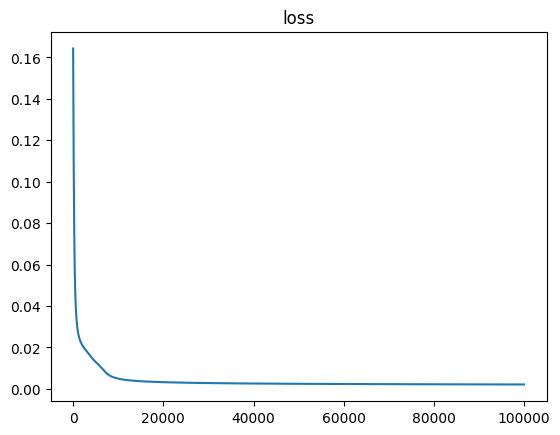

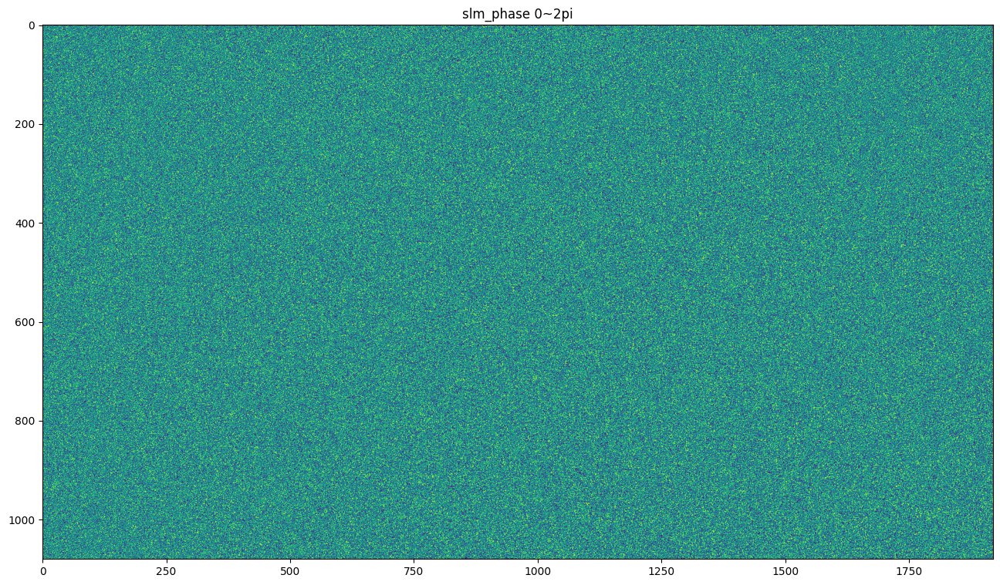

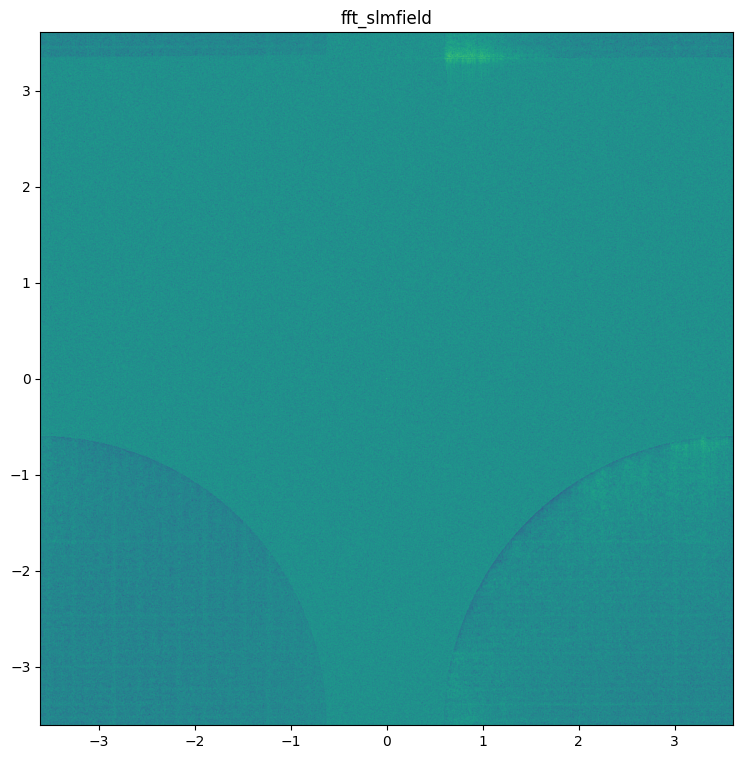

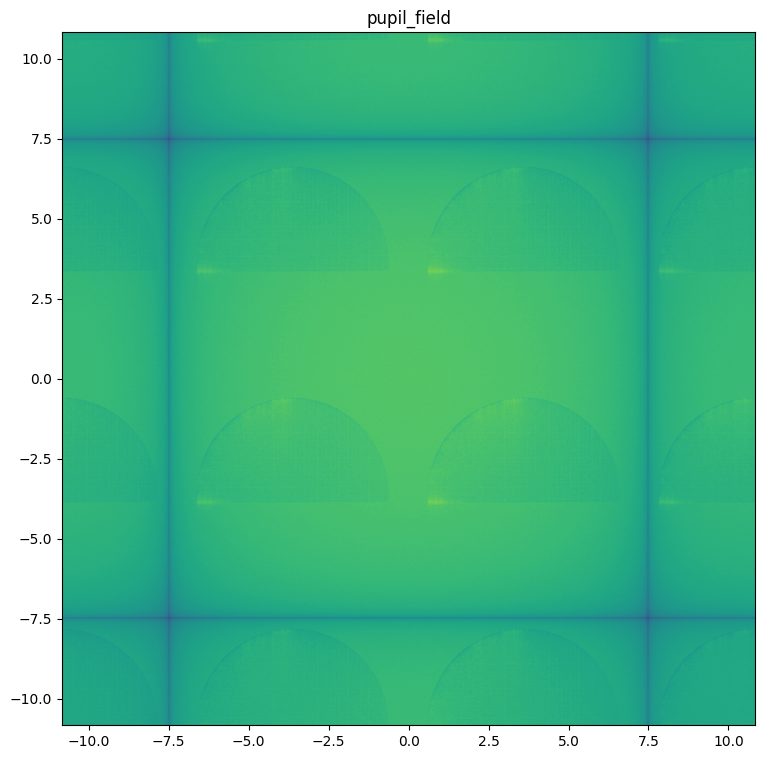

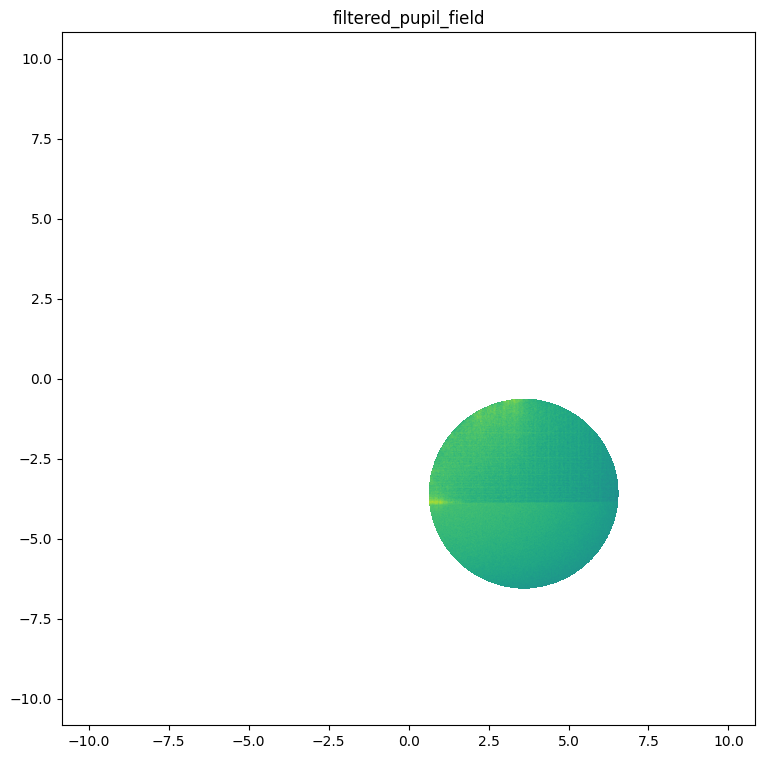

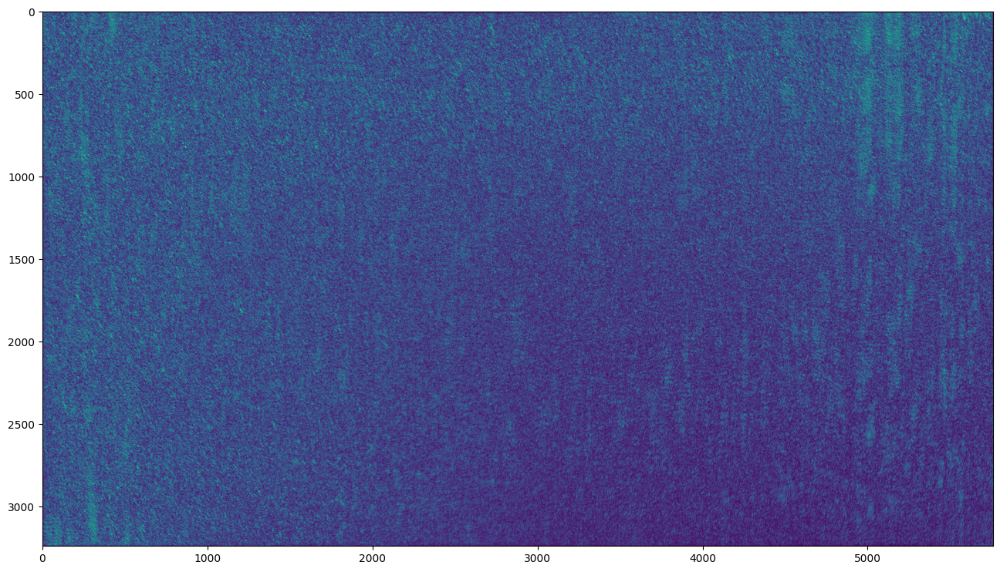

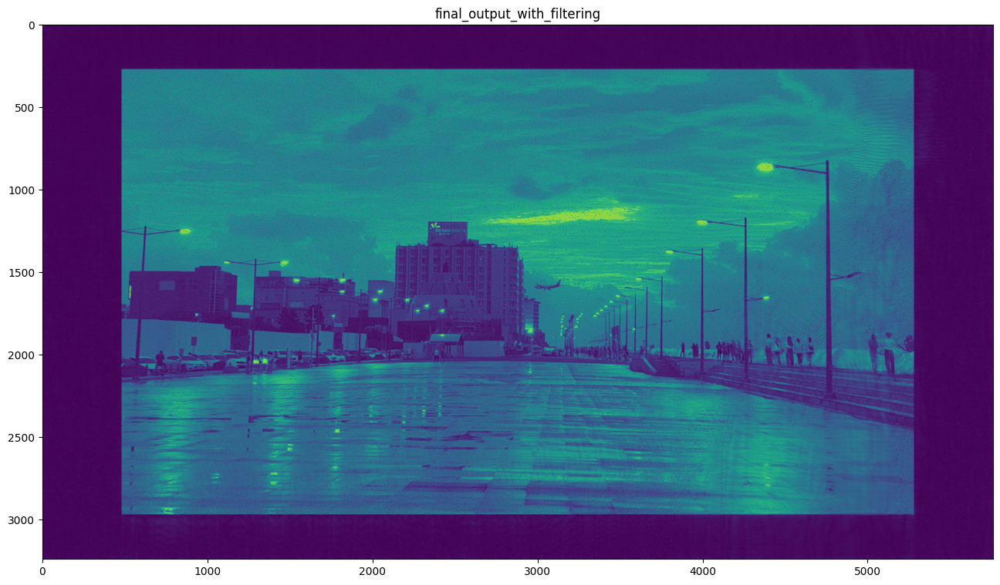

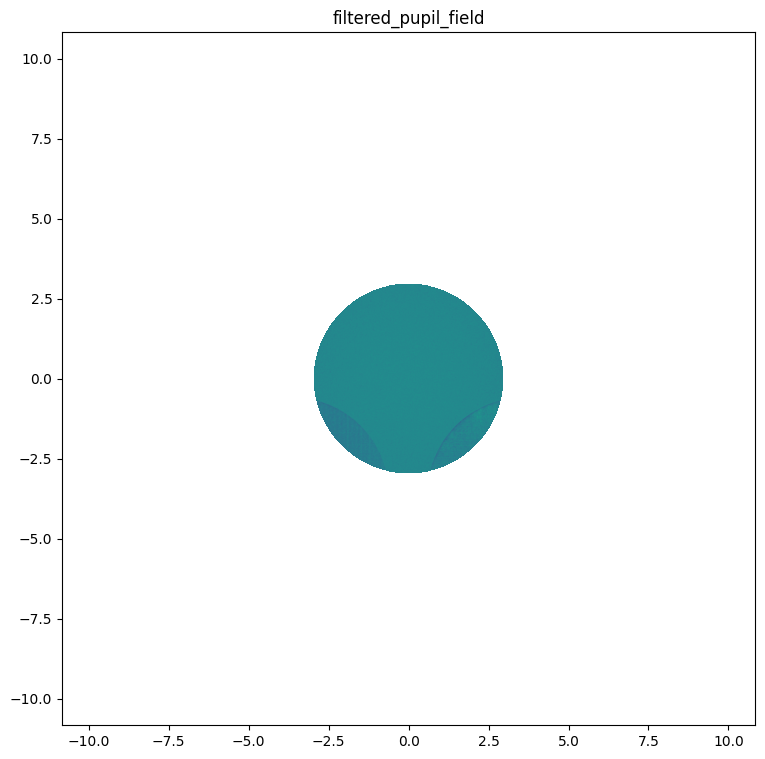

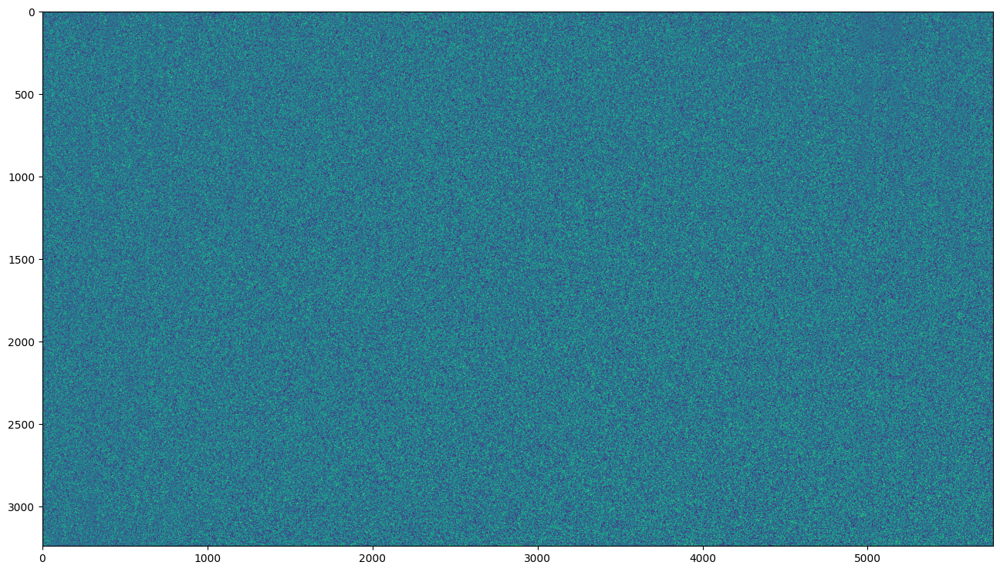

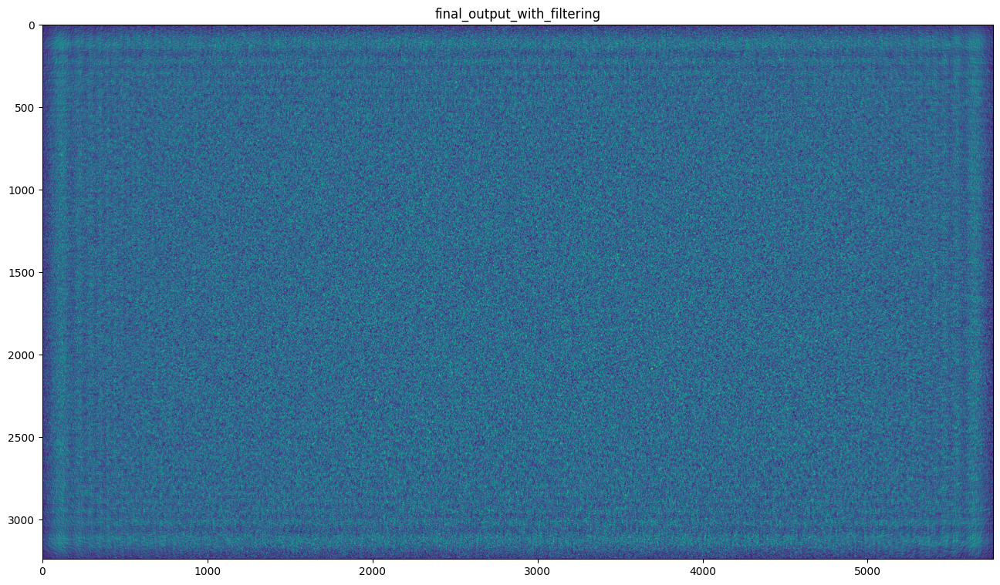

In [30]:
from matplotlib import cm
plt.figure()
plt.plot(x,y)
plt.title('loss')

prac_slm_phase = slm_phase % (2*torch.pi)
abs_prac_slm_phase = torch.clone(prac_slm_phase)
plt.figure(figsize=(16,9))
plt.imshow(abs(prac_slm_phase.cpu().detach()))
plt.title('slm_phase 0~2pi')
# img_prac_slm_phase = prac_slm_phase / torch.max(prac_slm_phase)
# img_prac_slm_phase = Image.fromarray(np.uint8(255*img_prac_slm_phase.cpu().detach().numpy()))
# img_prac_slm_phase.save('SLMphase={}mm_{}'.format(z/mm, img_name))
abs_prac_slm_phase = abs_prac_slm_phase - torch.min(abs_prac_slm_phase)
abs_prac_slm_phase = abs_prac_slm_phase / torch.max(abs_prac_slm_phase)
abs_prac_slm_phase = Image.fromarray(np.uint8(255*cm.viridis(abs_prac_slm_phase.cpu().detach())))
abs_prac_slm_phase.save('DH_phase.png')

pupil_field = torch.fft.ifftshift(torch.fft.fft2(torch.fft.fftshift(1+torch.exp(1j*prac_slm_phase))))
abs_pupil_field = abs(pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_pupil_field.cpu().detach()), extent=[min(flx/3)/mm, max(flx/3)/mm, min(fly/3)/mm, max(fly/3)/mm])
plt.title('fft_slmfield')
abs_pupil_field = abs_pupil_field - torch.min(abs_pupil_field)
abs_pupil_field = torch.log(abs_pupil_field)
abs_pupil_field = abs_pupil_field / torch.max(abs_pupil_field)
abs_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_pupil_field.cpu().detach())))
abs_pupil_field.save('DH_FFTfield.png')

rep_pupil_field = pupil_field.repeat(repnum,repnum)*torch.sinc(pa*rep_fyfy) * torch.sinc(pa*rep_fxfx)
abs_rep_pupil_field = abs(rep_pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_rep_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])
plt.title('pupil_field')
abs_rep_pupil_field = abs_rep_pupil_field - torch.min(abs_rep_pupil_field)
abs_rep_pupil_field = torch.log(abs_rep_pupil_field)
abs_rep_pupil_field = abs_rep_pupil_field / torch.max(abs_rep_pupil_field)
abs_rep_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_rep_pupil_field.cpu().detach())))
abs_rep_pupil_field.save('DH_repFFTfield.png')

pupil_func, flx, fly = mypupil(imgNx, imgNy, px, py, 3 * mm, 3.6 * mm, 3.6 * mm, wvl_laser, fl_EP, 3)
abs_pupil_func = torch.clone(pupil_func)
abs_pupil_func = abs_pupil_func - torch.min(abs_pupil_func)
abs_pupil_func = abs_pupil_func / torch.max(abs_pupil_func)
abs_pupil_func = Image.fromarray(np.uint8(255*cm.viridis(abs_pupil_func.cpu().detach())))
abs_pupil_func.save('DH_pupilwanted.png')

filtered_pupil_field = rep_pupil_field * pupil_func.to(device)
abs_filtered_pupil_field = abs(filtered_pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_filtered_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])
plt.title('filtered_pupil_field')
abs_filtered_pupil_field = abs_filtered_pupil_field - torch.min(abs_filtered_pupil_field)
abs_filtered_pupil_field = torch.log(abs_filtered_pupil_field)
abs_filtered_pupil_field = abs_filtered_pupil_field / torch.max(abs_filtered_pupil_field)
abs_filtered_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_pupil_field.cpu().detach())))
abs_filtered_pupil_field.save('DH_filteredFFTfield_wantedpupil.png')

filtered_slm_field = torch.fft.fftshift(torch.fft.ifft2(torch.fft.ifftshift(filtered_pupil_field)))
abs_filtered_slm_field = torch.abs(filtered_slm_field)
plt.figure(figsize=(16,9))
plt.imshow(abs_filtered_slm_field.cpu().detach())
abs_filtered_slm_field = abs_filtered_slm_field - torch.min(abs_filtered_slm_field)
abs_filtered_slm_field = abs_filtered_slm_field / torch.max(abs_filtered_slm_field)
abs_filtered_slm_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_slm_field.cpu().detach())))
abs_filtered_slm_field.save('DH_filteredslmfield_wantedpupil.png')

output_prac_tmp, dx,dy = FresnelPropagation_as(filtered_slm_field,px/3,py/3,z,wvl_laser)
output_prac_ = torch.abs(output_prac_tmp) / torch.max(torch.abs(output_prac_tmp))
plt.figure(figsize=(16,9))
plt.imshow(abs(output_prac_.cpu().detach()))
plt.title('final_output_with_filtering')
output_prac_ = output_prac_ - torch.min(output_prac_)
output_prac_ = output_prac_ / torch.max(output_prac_)
output_prac_ = Image.fromarray(np.uint8(255*cm.viridis(output_prac_.cpu().detach())))
output_prac_.save('DH_output_wantedpupil.png')

# output_prac_ROI = output_prac_[ROI_start[0]:ROI_start[0] + ROI_size[0], ROI_start[1]:ROI_start[1]+ROI_size[1]]
# plt.figure(figsize=(16,9))
# plt.imshow(abs(output_prac_ROI.cpu().detach()))
# plt.title('final_output_with_filtering_ROI')


pupil_func, flx, fly = mypupil(imgNx, imgNy, px, py, 3 * mm, 0 * mm, 0 * mm, wvl_laser, fl_EP, 3)
abs_pupil_func = torch.clone(pupil_func)
abs_pupil_func = abs_pupil_func - torch.min(abs_pupil_func)
abs_pupil_func = abs_pupil_func / torch.max(abs_pupil_func)
abs_pupil_func = Image.fromarray(np.uint8(255*cm.viridis(abs_pupil_func.cpu().detach())))
abs_pupil_func.save('DH_pupilunwanted.png')

filtered_pupil_field = rep_pupil_field.to(device) * pupil_func.to(device)
abs_filtered_pupil_field = abs(filtered_pupil_field)
fig, ax = plt.subplots(1,1,figsize=(9,9))
ax.imshow(np.log(abs_filtered_pupil_field.cpu().detach()), extent=[min(flx)/mm, max(flx)/mm, min(fly)/mm, max(fly)/mm])
plt.title('filtered_pupil_field')
abs_filtered_pupil_field = abs_filtered_pupil_field - torch.min(abs_filtered_pupil_field)
abs_filtered_pupil_field = torch.log(abs_filtered_pupil_field)
abs_filtered_pupil_field = abs_filtered_pupil_field / torch.max(abs_filtered_pupil_field)
abs_filtered_pupil_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_pupil_field.cpu().detach())))
abs_filtered_pupil_field.save('DH_filteredFFTfield_unwantedpupil.png')

filtered_slm_field = torch.fft.fftshift(torch.fft.ifft2(torch.fft.ifftshift(filtered_pupil_field)))
abs_filtered_slm_field = torch.abs(filtered_slm_field)
plt.figure(figsize=(16,9))
plt.imshow(abs_filtered_slm_field.cpu().detach())
abs_filtered_slm_field = abs_filtered_slm_field - torch.min(abs_filtered_slm_field)
abs_filtered_slm_field = torch.log(abs_filtered_slm_field)
abs_filtered_slm_field = abs_filtered_slm_field / torch.max(abs_filtered_slm_field)
abs_filtered_slm_field = Image.fromarray(np.uint8(255*cm.viridis(abs_filtered_slm_field.cpu().detach())))
abs_filtered_slm_field.save('DH_filteredslmfield_unwantedpupil.png')

output_prac_tmp, dx,dy = FresnelPropagation_as(filtered_slm_field,px/3,py/3,z,wvl_laser)
output_prac_ = torch.abs(output_prac_tmp) / torch.max(torch.abs(output_prac_tmp))
plt.figure(figsize=(16,9))
plt.imshow(abs(output_prac_.cpu().detach()))
plt.title('final_output_with_filtering')
output_prac_ = output_prac_ - torch.min(output_prac_)
output_prac_ = output_prac_ / torch.max(output_prac_)
output_prac_ = Image.fromarray(np.uint8(255*cm.viridis(output_prac_.cpu().detach())))
output_prac_.save('DH_output_unwantedpupil.png')
# output_prac_ROI = output_prac_[ROI_start[0]:ROI_start[0] + ROI_size[0], ROI_start[1]:ROI_start[1]+ROI_size[1]]
# plt.figure(figsize=(16,9))
# plt.imshow(abs(output_prac_ROI.cpu().detach()))
# plt.title('final_output_with_filtering_ROI')


In [106]:
print(rep_fx * wvl_laser)
print(flx/fl_EP)

tensor([-0.2167, -0.2166, -0.2165,  ...,  0.2165,  0.2166,  0.2167])
tensor([-0.2167, -0.2166, -0.2165,  ...,  0.2165,  0.2166,  0.2167])
